### Feature Extraction and Anomaly Detection in Time Series Data of Continuous Casting Process (Industrial)

Mold level fluctuation has always been one of the key factors in slab quality control. Abnormal fluctuations can easily cause slag entrainment and form surface defects of hot-rolled and cold-rolled steel sheets, thus reducing the product qualification rate. (Wang, et.al, 2024). 

This file is to try different feature engineering methods to break down the signals extracted from the manufacturing end, and to see if there are conspicuous flaws. Two datasets are used in this study, 3ZT and 4ZT, which are provided by  __*Baosteel R&D Center*__. According to their empirical observations, these two datasets are identified by experts as "significantly abnormal." Therefore, if a computer can detect anomalies in these two datasets, it will provide valuable insights into the "anomaly mechanism."


### Claim: The dataset is open, and it will be included in the dataset folder.


The first step:

### Pre-processing: Introduction to Three Important Signals

- **1. Mold Level m(t):** Mold Level refers to the height of molten metal inside the mold during the continuous casting process. Maintaining a consistent mold level is crucial because fluctuations can lead to defects in the cast product.

- **2. Stopper Position s(t):** Stopper Position relates to the location of the stopper rod, which controls the flow of molten metal from the tundish into the mold. The stopper rod can be raised or lowered to adjust the flow rate.

- **3. Argon Pressure a(t):** Argon Pressure refers to the pressure of argon gas that is injected into the molten metal flow, typically through the stopper rod or submerged entry nozzle (SEN). The primary purpose of argon injection is to prevent the formation of solid inclusions and to reduce the risk of clogging in the SEN.

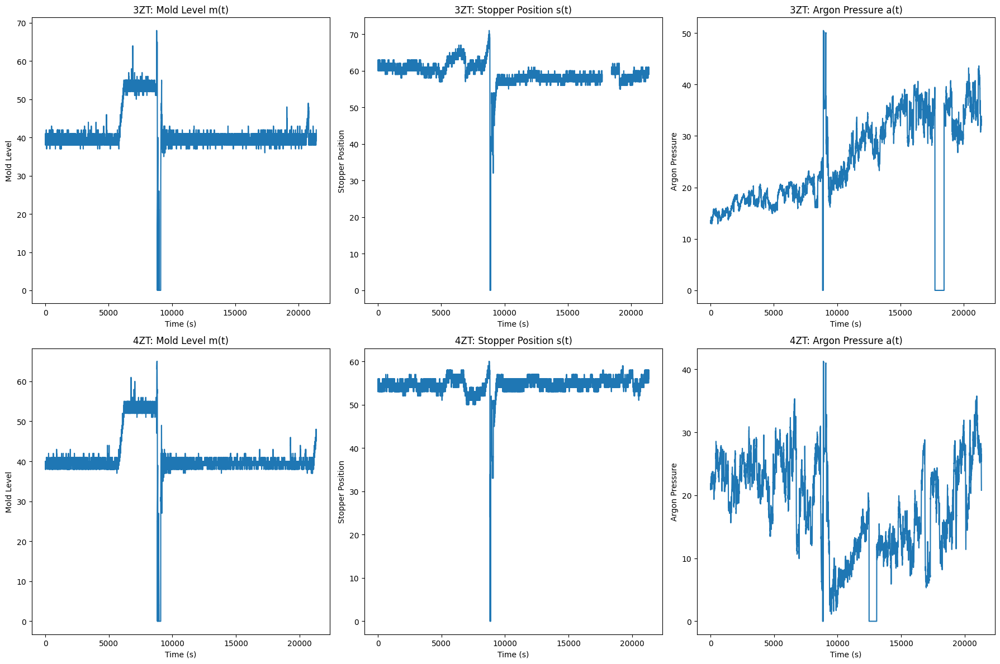

In [3]:
import pandas as pd
import matplotlib.pyplot as plt

# Load the two Excel files
file_3ZT = pd.read_excel('21837-3ZT.xlsx')
file_4ZT = pd.read_excel('21837-4ZT.xlsx')

# Extract relevant columns for plotting
m_t_3ZT = file_3ZT['MoldLevel']
s_t_3ZT = file_3ZT['StopperPosition']
a_t_3ZT = file_3ZT['ArgonPressure']

m_t_4ZT = file_4ZT['MoldLevel']
s_t_4ZT = file_4ZT['StopperPosition']
a_t_4ZT = file_4ZT['ArgonPressure']

# Create subplots
fig, axs = plt.subplots(2, 3, figsize=(18, 12))

# Plot 3ZT signals
axs[0, 0].plot(m_t_3ZT)
axs[0, 0].set_title("3ZT: Mold Level m(t)")
axs[0, 0].set_xlabel("Time (s)")
axs[0, 0].set_ylabel("Mold Level")

axs[0, 1].plot(s_t_3ZT)
axs[0, 1].set_title("3ZT: Stopper Position s(t)")
axs[0, 1].set_xlabel("Time (s)")
axs[0, 1].set_ylabel("Stopper Position")

axs[0, 2].plot(a_t_3ZT)
axs[0, 2].set_title("3ZT: Argon Pressure a(t)")
axs[0, 2].set_xlabel("Time (s)")
axs[0, 2].set_ylabel("Argon Pressure")

# Plot 4ZT signals
axs[1, 0].plot(m_t_4ZT)
axs[1, 0].set_title("4ZT: Mold Level m(t)")
axs[1, 0].set_xlabel("Time (s)")
axs[1, 0].set_ylabel("Mold Level")

axs[1, 1].plot(s_t_4ZT)
axs[1, 1].set_title("4ZT: Stopper Position s(t)")
axs[1, 1].set_xlabel("Time (s)")
axs[1, 1].set_ylabel("Stopper Position")

axs[1, 2].plot(a_t_4ZT)
axs[1, 2].set_title("4ZT: Argon Pressure a(t)")
axs[1, 2].set_xlabel("Time (s)")
axs[1, 2].set_ylabel("Argon Pressure")

# Adjust layout
plt.tight_layout()
plt.show()


# Observation

These are the raw signals, and it is quite obvious that they are not stationary. As a matter of fact, they are quite chaotic.


So now, we need to make it stationary - using differencing, with the lag of 10. 

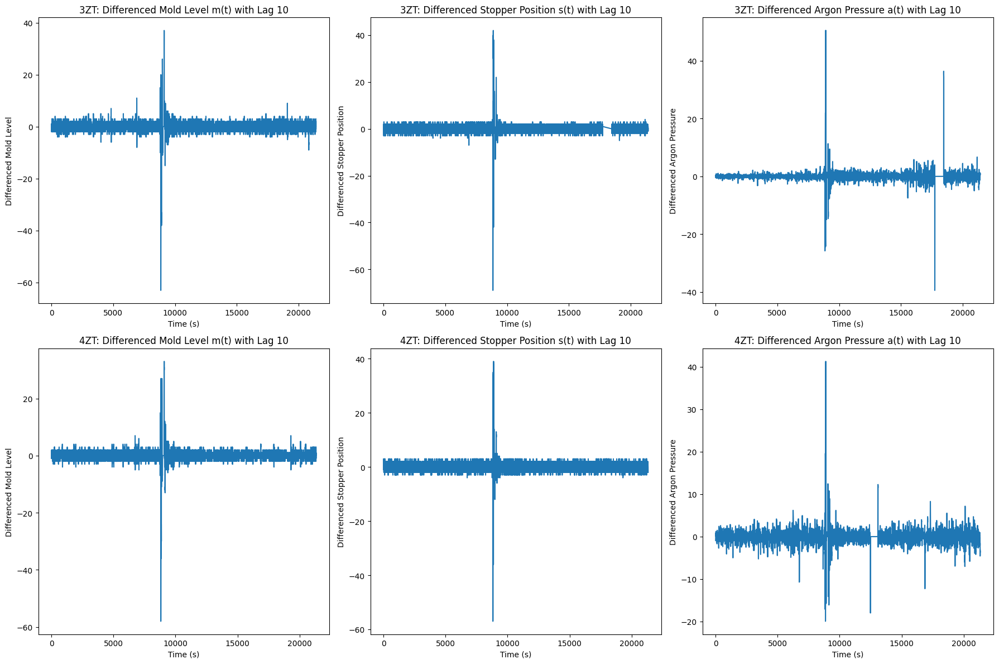

In [4]:
# 3ZT signals with differencing
m_t_3ZT_diff = m_t_3ZT.diff(periods=10).dropna()
s_t_3ZT_diff = s_t_3ZT.diff(periods=10).dropna()
a_t_3ZT_diff = a_t_3ZT.diff(periods=10).dropna()

# 4ZT signals with differencing
m_t_4ZT_diff = m_t_4ZT.diff(periods=10).dropna()
s_t_4ZT_diff = s_t_4ZT.diff(periods=10).dropna()
a_t_4ZT_diff = a_t_4ZT.diff(periods=10).dropna()

# Create subplots to visualize the differenced signals
fig, axs = plt.subplots(2, 3, figsize=(18, 12))

# Plot differenced 3ZT signals
axs[0, 0].plot(m_t_3ZT_diff)
axs[0, 0].set_title("3ZT: Differenced Mold Level m(t) with Lag 10")
axs[0, 0].set_xlabel("Time (s)")
axs[0, 0].set_ylabel("Differenced Mold Level")

axs[0, 1].plot(s_t_3ZT_diff)
axs[0, 1].set_title("3ZT: Differenced Stopper Position s(t) with Lag 10")
axs[0, 1].set_xlabel("Time (s)")
axs[0, 1].set_ylabel("Differenced Stopper Position")

axs[0, 2].plot(a_t_3ZT_diff)
axs[0, 2].set_title("3ZT: Differenced Argon Pressure a(t) with Lag 10")
axs[0, 2].set_xlabel("Time (s)")
axs[0, 2].set_ylabel("Differenced Argon Pressure")

# Plot differenced 4ZT signals
axs[1, 0].plot(m_t_4ZT_diff)
axs[1, 0].set_title("4ZT: Differenced Mold Level m(t) with Lag 10")
axs[1, 0].set_xlabel("Time (s)")
axs[1, 0].set_ylabel("Differenced Mold Level")

axs[1, 1].plot(s_t_4ZT_diff)
axs[1, 1].set_title("4ZT: Differenced Stopper Position s(t) with Lag 10")
axs[1, 1].set_xlabel("Time (s)")
axs[1, 1].set_ylabel("Differenced Stopper Position")

axs[1, 2].plot(a_t_4ZT_diff)
axs[1, 2].set_title("4ZT: Differenced Argon Pressure a(t) with Lag 10")
axs[1, 2].set_xlabel("Time (s)")
axs[1, 2].set_ylabel("Differenced Argon Pressure")

# Adjust layout
plt.tight_layout()
plt.show()


**Good news**: Now, we have signals symmetric according to 0, which indicates stationarity. However, you can see that there are some extreme vertical lines within the signals. These represent abnormalities. 

These abnormalities are well-documented in previous literature, and although they are the "key feature," our objective is to identify other features that can help "forecast," "envision," or "foresee" these key abnormalities. 

Since these vertical lines are not our primary focus and they contaminate the signals, we will be removing them.

*Removing points above 10 or below -10.*


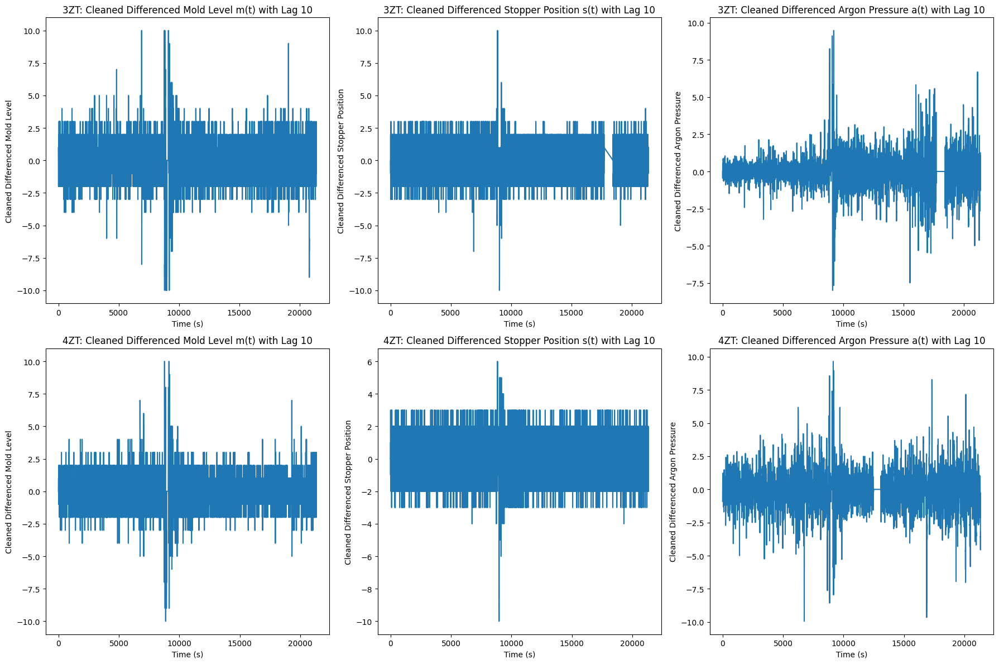

In [5]:
upper_threshold = 10
lower_threshold = -10

# 3ZT signals with differencing and outlier removal
m_t_3ZT_diff_cleaned = m_t_3ZT_diff[(m_t_3ZT_diff <= upper_threshold) & (m_t_3ZT_diff >= lower_threshold)]
s_t_3ZT_diff_cleaned = s_t_3ZT_diff[(s_t_3ZT_diff <= upper_threshold) & (s_t_3ZT_diff >= lower_threshold)]
a_t_3ZT_diff_cleaned = a_t_3ZT_diff[(a_t_3ZT_diff <= upper_threshold) & (a_t_3ZT_diff >= lower_threshold)]

# 4ZT signals with differencing and outlier removal
m_t_4ZT_diff_cleaned = m_t_4ZT_diff[(m_t_4ZT_diff <= upper_threshold) & (m_t_4ZT_diff >= lower_threshold)]
s_t_4ZT_diff_cleaned = s_t_4ZT_diff[(s_t_4ZT_diff <= upper_threshold) & (s_t_4ZT_diff >= lower_threshold)]
a_t_4ZT_diff_cleaned = a_t_4ZT_diff[(a_t_4ZT_diff <= upper_threshold) & (a_t_4ZT_diff >= lower_threshold)]

# Create subplots to visualize the cleaned differenced signals
fig, axs = plt.subplots(2, 3, figsize=(18, 12))

# Plot cleaned differenced 3ZT signals
axs[0, 0].plot(m_t_3ZT_diff_cleaned)
axs[0, 0].set_title("3ZT: Cleaned Differenced Mold Level m(t) with Lag 10")
axs[0, 0].set_xlabel("Time (s)")
axs[0, 0].set_ylabel("Cleaned Differenced Mold Level")

axs[0, 1].plot(s_t_3ZT_diff_cleaned)
axs[0, 1].set_title("3ZT: Cleaned Differenced Stopper Position s(t) with Lag 10")
axs[0, 1].set_xlabel("Time (s)")
axs[0, 1].set_ylabel("Cleaned Differenced Stopper Position")

axs[0, 2].plot(a_t_3ZT_diff_cleaned)
axs[0, 2].set_title("3ZT: Cleaned Differenced Argon Pressure a(t) with Lag 10")
axs[0, 2].set_xlabel("Time (s)")
axs[0, 2].set_ylabel("Cleaned Differenced Argon Pressure")

# Plot cleaned differenced 4ZT signals
axs[1, 0].plot(m_t_4ZT_diff_cleaned)
axs[1, 0].set_title("4ZT: Cleaned Differenced Mold Level m(t) with Lag 10")
axs[1, 0].set_xlabel("Time (s)")
axs[1, 0].set_ylabel("Cleaned Differenced Mold Level")

axs[1, 1].plot(s_t_4ZT_diff_cleaned)
axs[1, 1].set_title("4ZT: Cleaned Differenced Stopper Position s(t) with Lag 10")
axs[1, 1].set_xlabel("Time (s)")
axs[1, 1].set_ylabel("Cleaned Differenced Stopper Position")

axs[1, 2].plot(a_t_4ZT_diff_cleaned)
axs[1, 2].set_title("4ZT: Cleaned Differenced Argon Pressure a(t) with Lag 10")
axs[1, 2].set_xlabel("Time (s)")
axs[1, 2].set_ylabel("Cleaned Differenced Argon Pressure")

# Adjust layout
plt.tight_layout()
plt.show()

**Now we want to extract the "erroneous features,"** *what could they be? Energy? Frequency?* 

As colleagues have shown, analyzing the signal per **128 seconds** is a *sweet spot*. **Segmenting the entire signal** is *crucial* for both algorithm efficiency and visualization for humans. Our eyes are only able to capture obvious fluctuations, and the graphs above are not effective for highlighting patterns because they are *too crowded*.

**Empirical Mode Decomposition (EMD)** is also a *crucial method* for extracting the inherent details. Therefore, we introduce **Hilbert-Huang Transformation (HHT)**, which is a combination of both EMD and Fourier Discrete Transformation. *Worth mentioning*, HHT can only be applied to signals that are 1. *linear (or simply discrete)* and 2. *either stationary or strictly periodic*.
                                                                                                                                               

in case if you haven't install EMD-signal which is used to perform HHT \
     - pip install EMD-signal

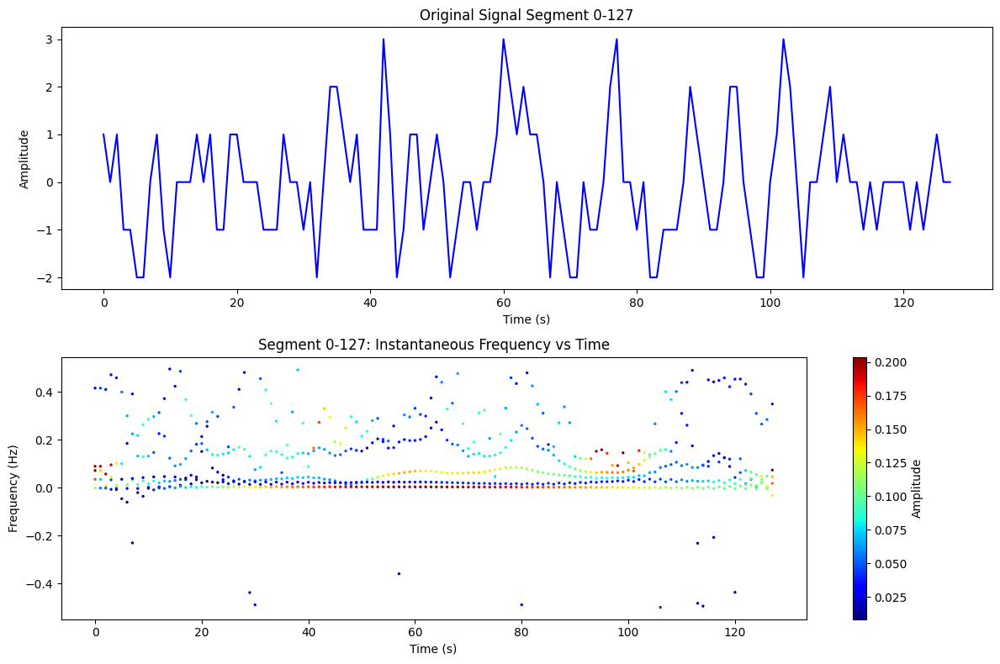

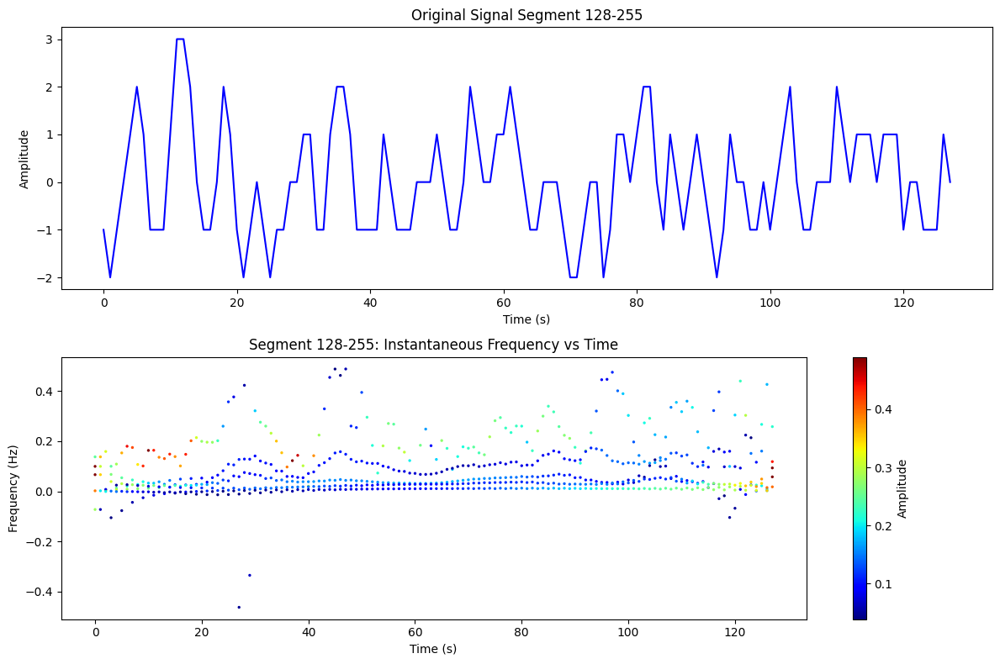

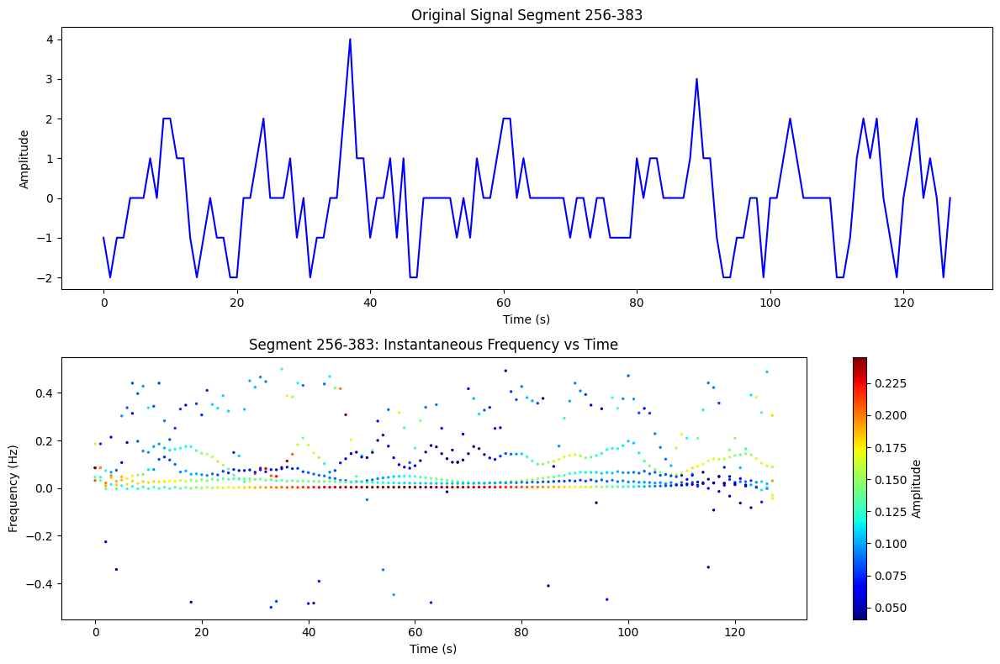

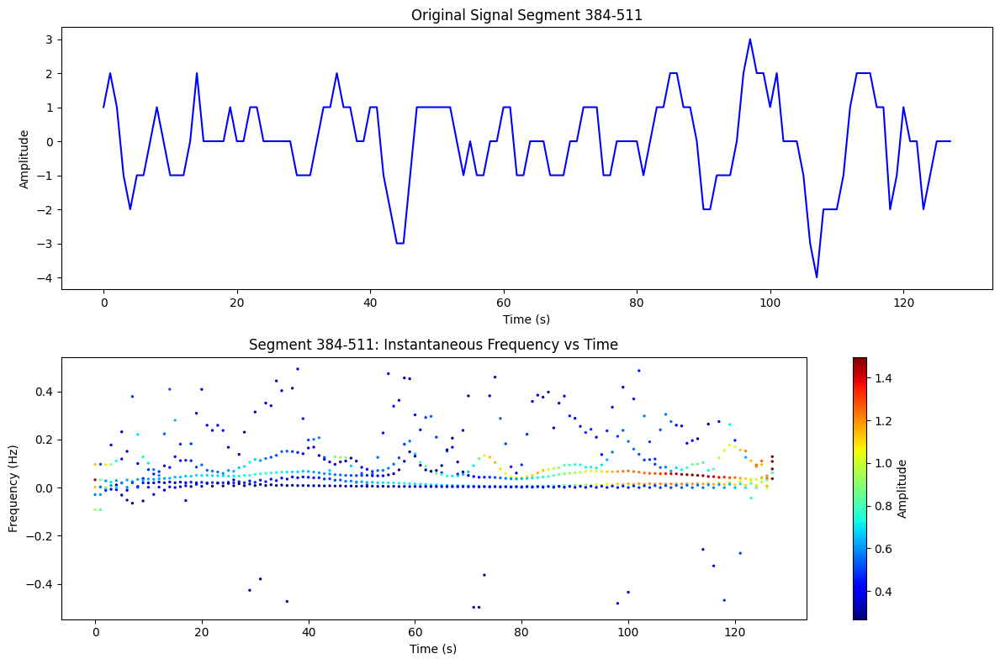

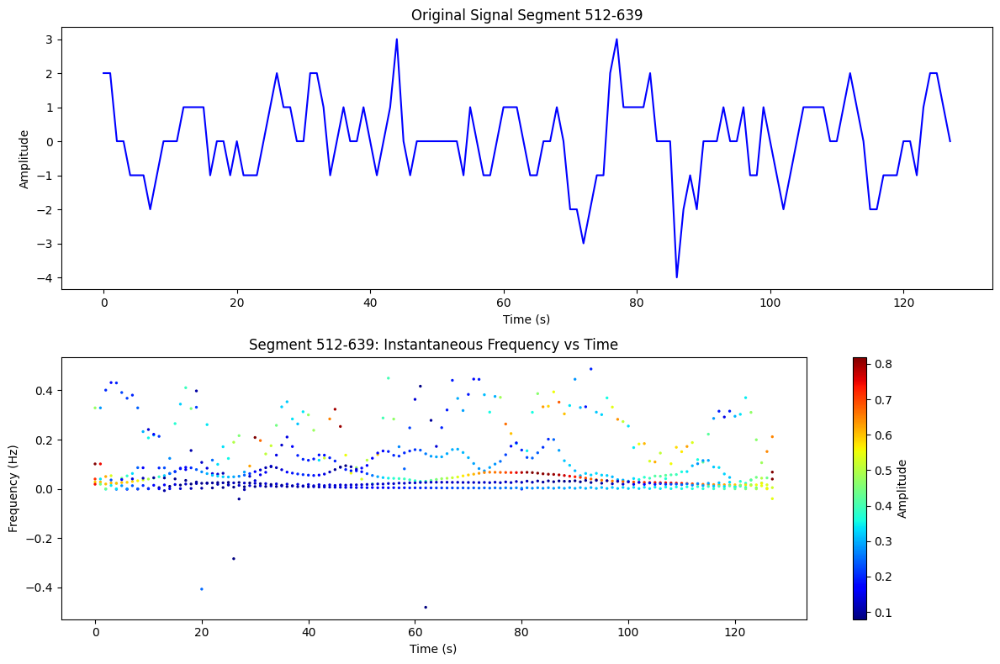

...

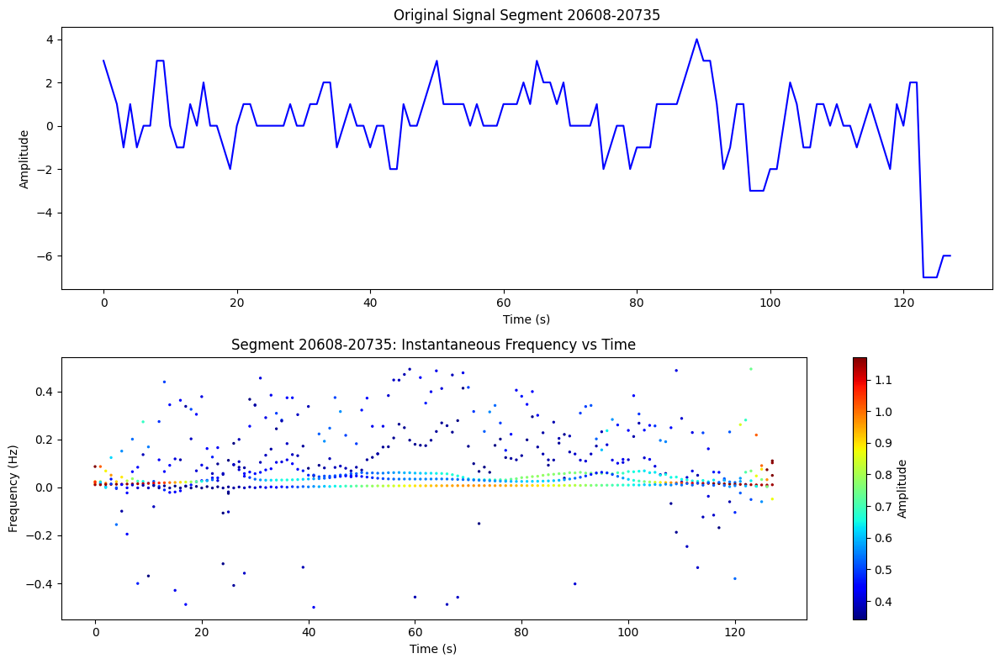

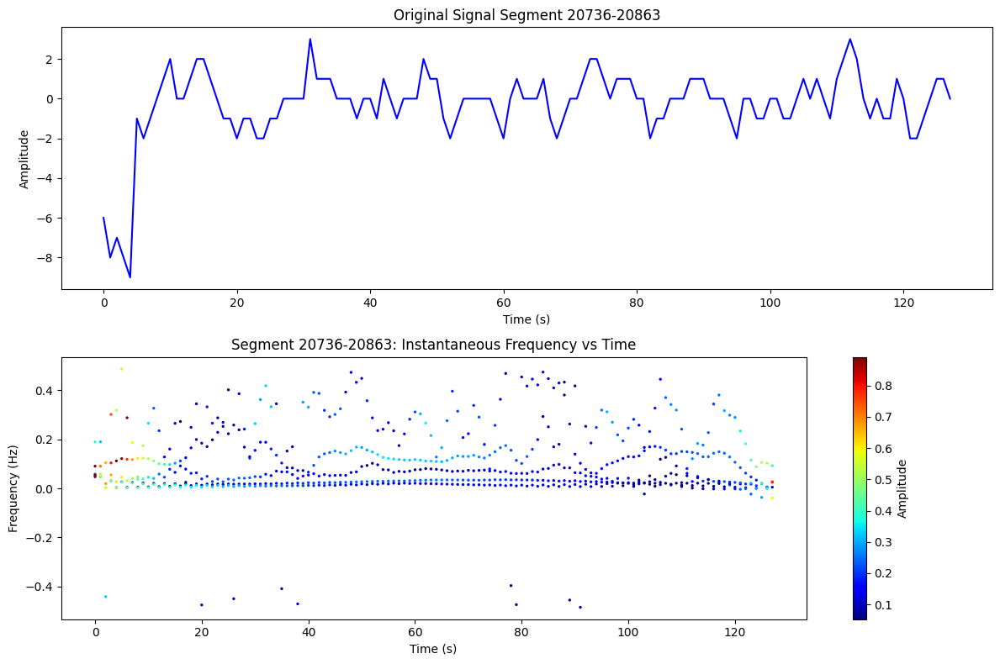

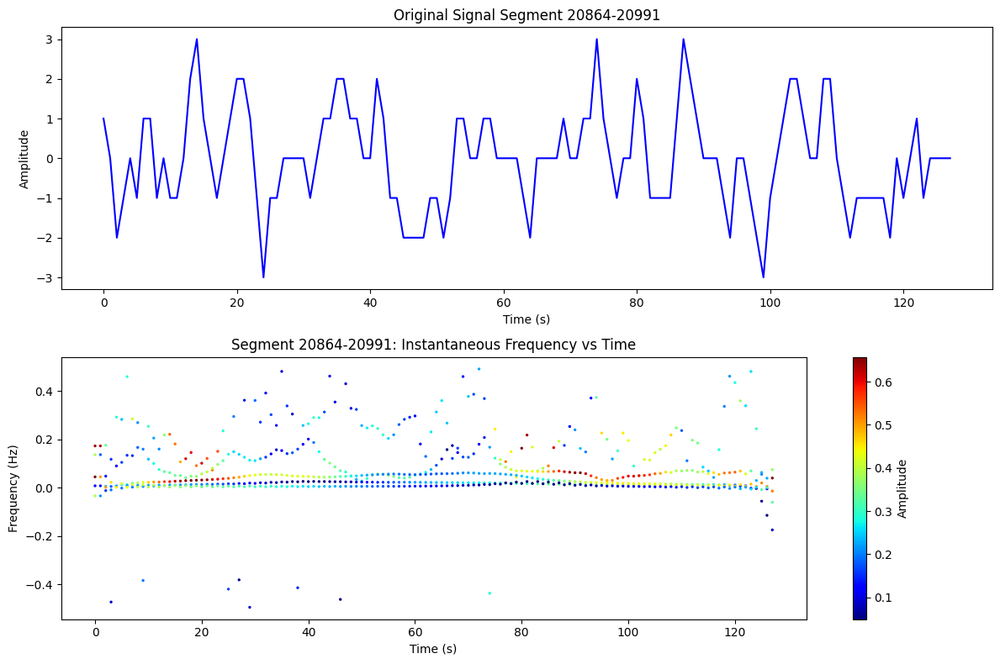

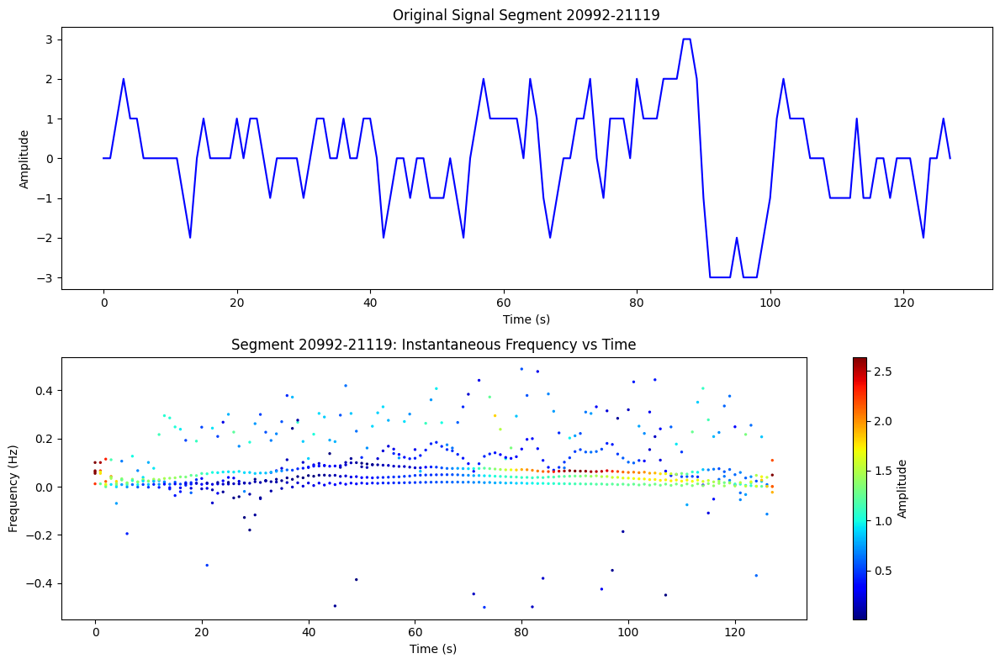

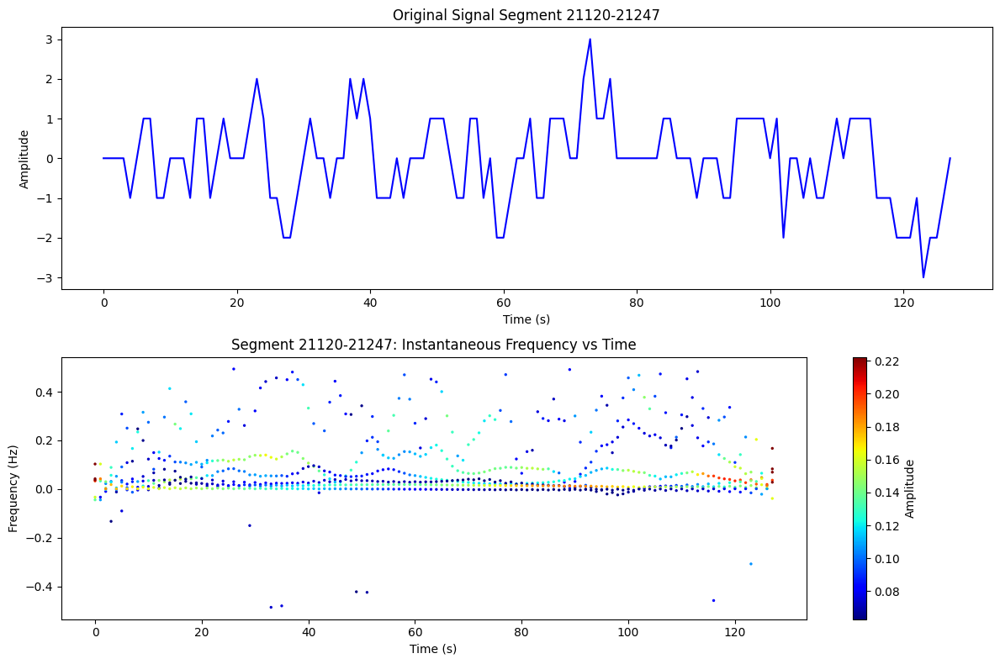

In [17]:
import numpy as np
import matplotlib.pyplot as plt
from pyhht.emd import EMD
from scipy.signal import hilbert

# Assuming m_t_3ZT_diff_cleaned is your differenced and cleaned signal from previous steps
signal = m_t_3ZT_diff_cleaned.to_numpy()  # Convert to numpy array

# Parameters
segment_length = 128  # Length of each segment in seconds
sampling_rate = 1  # Assuming 1 sample per second

# Total number of samples per segment
samples_per_segment = segment_length * sampling_rate

# Number of segments
num_segments = len(signal) // samples_per_segment

# Loop over each segment and perform HHT
for i in range(num_segments):
    start_idx = i * samples_per_segment
    end_idx = start_idx + samples_per_segment
    segment = signal[start_idx:end_idx]
    
    # Apply EMD to get IMFs
    decomposer = EMD(segment)
    imfs = decomposer.decompose()
    
    # Create a figure with two subplots side by side
    fig, axs = plt.subplots(2, 1, figsize=(12, 8))
    
    # Plot the original signal segment
    axs[0].plot(np.arange(segment_length), segment, color='blue')
    axs[0].set_title(f"Original Signal Segment {start_idx}-{end_idx - 1}")
    axs[0].set_xlabel("Time (s)")
    axs[0].set_ylabel("Amplitude")
    
    # Plot each IMF's instantaneous frequency vs time with amplitude as color intensity
    for idx, imf in enumerate(imfs):
        # Hilbert transform to get amplitude and frequency
        analytic_signal = hilbert(imf)
        amplitude_envelope = np.abs(analytic_signal)
        instantaneous_phase = np.unwrap(np.angle(analytic_signal))
        instantaneous_frequency = np.diff(instantaneous_phase) / (2.0 * np.pi) * sampling_rate
        
        # Pad instantaneous_frequency to match amplitude length
        instantaneous_frequency = np.pad(instantaneous_frequency, (1, 0), mode='edge')
        
        # Plot frequency vs time with amplitude as color intensity
        scatter = axs[1].scatter(np.arange(segment_length), instantaneous_frequency, c=amplitude_envelope, cmap='jet', s=2)
    
    axs[1].set_title(f"Segment {start_idx}-{end_idx - 1}: Instantaneous Frequency vs Time")
    axs[1].set_xlabel("Time (s)")
    axs[1].set_ylabel("Frequency (Hz)")
    plt.colorbar(scatter, ax=axs[1], label='Amplitude')
    
    # Adjust layout
    plt.tight_layout()
    plt.show()


In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import pywt
import numpy as np
from mpl_toolkits.mplot3d import Axes3D

# Load the Excel file
file_path = '21837-3ZT.xlsx'
df = pd.read_excel(file_path)

# Compute the first difference for MoldLevel and StopperPosition
df['MoldLevel-Diff1'] = df['MoldLevel'].diff()
df['StopperPosition-Diff1'] = df['StopperPosition'].diff()

# Define a function to plot wavelet decompositions
def plot_wavelet_decomposition(signal, title, filename):
    coeffs = pywt.wavedec(signal, 'db1', level=5)
    fig, axs = plt.subplots(len(coeffs), 1, figsize=(12, 18))
    fig.suptitle(title)
    for i, coeff in enumerate(coeffs):
        axs[i].plot(coeff)
        axs[i].set_title(f"Level {i+1} {'Approximation' if i == 0 else 'Detail'}")
    plt.tight_layout()
    plt.savefig(filename)
    plt.show()
    return coeffs

# Extract the relevant columns and drop NA values
s_t = df['StopperPosition'].dropna().values
m_t = df['MoldLevel'].dropna().values
s_t_diff1 = df['StopperPosition-Diff1'].dropna().values
m_t_diff1 = df['MoldLevel-Diff1'].dropna().values

# Plot wavelet decompositions for s(t) and m(t)
coeffs_s_t = plot_wavelet_decomposition(s_t, "Wavelet Decomposition of s(t)", "Wavelet Decomposition - StopperPosition.png")
coeffs_m_t = plot_wavelet_decomposition(m_t, "Wavelet Decomposition of m(t)", "Wavelet Decomposition - MoldLevel.png")

# Plot wavelet decompositions for s'(t) and m'(t)
coeffs_s_t_diff1 = plot_wavelet_decomposition(s_t_diff1, "Wavelet Decomposition of s'(t)", "Wavelet Decomposition StopperPosition Diff-1.png")
coeffs_m_t_diff1 = plot_wavelet_decomposition(m_t_diff1, "Wavelet Decomposition of m'(t)", "Wavelet Decomposition Diff-1 - MoldLevel.png")

# Define a function for 3D plot of the wavelet decomposition coefficients
def plot_3d_wavelet(coeffs, title, filename):
    fig = plt.figure(figsize=(10, 8))
    ax = fig.add_subplot(111, projection='3d')
    for i, coeff in enumerate(coeffs):
        x = np.linspace(0, len(coeffs[0]), len(coeff))  # Adjust x-coordinates for 3D plot
        y = np.full_like(x, i)
        z = coeff
        ax.plot(x, y, z, label=f"Level {i+1}")
    ax.set_title(title)
    ax.set_xlabel('Time')
    ax.set_ylabel('Level')
    ax.set_zlabel('Coefficient')
    plt.legend()
    plt.savefig(filename)
    plt.show()

# Plot and save 3D wavelet decomposition for s(t)
plot_3d_wavelet(coeffs_s_t, "3D Wavelet Decomposition of s(t)", "3d_wavelet_decomposition_s_t.png")

# Plot and save 3D wavelet decomposition for m(t)
plot_3d_wavelet(coeffs_m_t, "3D Wavelet Decomposition of m(t)", "3d_wavelet_decomposition_m_t.png")

# Plot and save 3D wavelet decomposition for s'(t)
plot_3d_wavelet(coeffs_s_t_diff1, "3D Wavelet Decomposition of s'(t)", "3d_wavelet_decomposition_s_t_diff1.png")

# Plot and save 3D wavelet decomposition for m'(t)
plot_3d_wavelet(coeffs_m_t_diff1, "3D Wavelet Decomposition of m'(t)", "3d_wavelet_decomposition_m_t_diff1.png")


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import find_peaks
from scipy.stats import entropy
from scipy.integrate import simps

# Load the Excel file
file_path = '21837-3ZT.xlsx'
df = pd.read_excel(file_path)

# Function to fill NA values with the mean of previous and succeeding values
def fill_na_with_mean(df, column):
    df[column] = df[column].fillna((df[column].ffill() + df[column].bfill()) / 2)
    return df

# Fill NA values for the relevant columns
df = fill_na_with_mean(df, 'ArgonPressure')
df = fill_na_with_mean(df, 'StopperPosition')
df = fill_na_with_mean(df, 'MoldLevel')

# Extract the relevant columns
a_t = df['ArgonPressure'].values
s_t = df['StopperPosition'].values
m_t = df['MoldLevel'].values

# Function to calculate various time series features
def time_series_features(signal):
    features = {}
    
    # Autocorrelation
    features['Autocorrelation'] = np.correlate(signal, signal, mode='full')[len(signal)-1]
    
    # Centroid
    features['Centroid'] = np.mean(signal)
    
    # Mean Differences
    diff_signal = np.diff(signal)
    features['Mean Differences'] = np.mean(diff_signal)
    
    # Mean Absolute Differences
    features['Mean Absolute Differences'] = np.mean(np.abs(diff_signal))
    
    # Median Differences
    features['Median Differences'] = np.median(diff_signal)
    
    # Median Absolute Differences
    features['Median Absolute Differences'] = np.median(np.abs(diff_signal))
    
    # Sum of Absolute Differences
    features['Sum of Absolute Differences'] = np.sum(np.abs(diff_signal))
    
    # Entropy
    features['Entropy'] = entropy(np.abs(signal))
    
    # Area Under the Curve
    features['Area Under the Curve'] = simps(signal)
    
    # Maximum Peaks
    features['Number of Maximum Peaks'] = len(find_peaks(signal)[0])
    
    # Minimum Peaks
    features['Number of Minimum Peaks'] = len(find_peaks(-signal)[0])
    
    # Zero Crossing Rate
    features['Zero Crossing Rate'] = ((signal[:-1] * signal[1:]) < 0).sum()
    
    return features

# Calculate features for a(t), s(t), and m(t)
features_a_t = time_series_features(a_t)
features_s_t = time_series_features(s_t)
features_m_t = time_series_features(m_t)

# Display the features
print("Features of a(t) (ArgonPressure):", features_a_t)
print("Features of s(t) (StopperPosition):", features_s_t)
print("Features of m(t) (MoldLevel):", features_m_t)

# Check relationships between signals
correlation_as = np.corrcoef(a_t, s_t)[0, 1]
correlation_am = np.corrcoef(a_t, m_t)[0, 1]
correlation_sm = np.corrcoef(s_t, m_t)[0, 1]

print("\nCorrelation between a(t) and s(t):", correlation_as)
print("Correlation between a(t) and m(t):", correlation_am)
print("Correlation between s(t) and m(t):", correlation_sm)

# Plot the signals for visual inspection
plt.figure(figsize=(15, 10))
plt.subplot(3, 1, 1)
plt.plot(a_t)
plt.title("a(t) (ArgonPressure)")

plt.subplot(3, 1, 2)
plt.plot(s_t)
plt.title("s(t) (StopperPosition)")

plt.subplot(3, 1, 3)
plt.plot(m_t)
plt.title("m(t) (MoldLevel)")

plt.tight_layout()
plt.savefig('orignal wave of three.png')
plt.show()


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.fftpack import fft
from scipy.signal import find_peaks, hilbert
from scipy.stats import entropy
from scipy.integrate import simps
import pywt
from sklearn.decomposition import PCA

# Load the Excel file
file_path = '21837-3ZT.xlsx'
df = pd.read_excel(file_path)

# Function to fill NA values with the mean of previous and succeeding values
def fill_na_with_mean(df, column):
    df[column] = df[column].fillna((df[column].ffill() + df[column].bfill()) / 2)
    return df

# Fill NA values for the relevant columns
df = fill_na_with_mean(df, 'ArgonPressure')
df = fill_na_with_mean(df, 'StopperPosition')
df = fill_na_with_mean(df, 'MoldLevel')

# Extract the relevant columns
a_t = df['ArgonPressure'].values
s_t = df['StopperPosition'].values
m_t = df['MoldLevel'].values

# Fourier Transform with threshold filtering and amplitude cap
def plot_fourier_transform(signal, title, filename, threshold=0.01, amplitude_cap=100000):
    n = len(signal)
    signal_fft = fft(signal)
    signal_freq = np.fft.fftfreq(n)
    
    # Filter out low-amplitude components
    amplitude = np.abs(signal_fft)
    significant_freq = signal_freq[(amplitude > threshold * np.max(amplitude)) & (amplitude < amplitude_cap)]
    significant_amplitude = amplitude[(amplitude > threshold * np.max(amplitude)) & (amplitude < amplitude_cap)]
    
    plt.figure(figsize=(12, 6))
    plt.stem(significant_freq, significant_amplitude, basefmt=" ", use_line_collection=True)
    plt.title(f'Fourier Transform of {title} (Filtered)')
    plt.xlabel('Frequency')
    plt.ylabel('Amplitude')
    plt.ylim(0, amplitude_cap)
    plt.savefig(filename)
    plt.show()

# Plot and save Fourier Transforms
plot_fourier_transform(a_t, 'a(t) (ArgonPressure)', 'fourier_transform_a_t.png')
plot_fourier_transform(s_t, 's(t) (StopperPosition)', 'fourier_transform_s_t.png')
plot_fourier_transform(m_t, 'm(t) (MoldLevel)', 'fourier_transform_m_t.png')

# Wavelet Transform
def plot_wavelet_transform(signal, title, filename):
    coef, freqs = pywt.cwt(signal, np.arange(1, 128), 'gaus1')
    plt.figure(figsize=(12, 6))
    plt.imshow(coef, extent=[0, len(signal), 1, 128], cmap='PRGn', aspect='auto',
               vmax=abs(coef).max(), vmin=-abs(coef).max())
    plt.title(f'Wavelet Transform of {title}')
    plt.ylabel('Frequency (log scale)')
    plt.xlabel('Time')
    plt.savefig(filename)
    plt.show()

# Plot and save Wavelet Transforms
plot_wavelet_transform(a_t, 'a(t) (ArgonPressure)', 'wavelet_transform_a_t.png')
plot_wavelet_transform(s_t, 's(t) (StopperPosition)', 'wavelet_transform_s_t.png')
plot_wavelet_transform(m_t, 'm(t) (MoldLevel)', 'wavelet_transform_m_t.png')

# Hilbert Transform
def plot_hilbert_transform(signal, title, filename):
    analytic_signal = hilbert(signal)
    amplitude_envelope = np.abs(analytic_signal)
    instantaneous_phase = np.unwrap(np.angle(analytic_signal))
    instantaneous_frequency = (np.diff(instantaneous_phase) / (2.0*np.pi) * len(signal))
    
    plt.figure(figsize=(12, 8))
    plt.subplot(3, 1, 1)
    plt.plot(signal)
    plt.title(f'Original Signal: {title}')
    
    plt.subplot(3, 1, 2)
    plt.plot(amplitude_envelope)
    plt.title('Amplitude Envelope')
    
    plt.subplot(3, 1, 3)
    plt.plot(instantaneous_frequency)
    plt.title('Instantaneous Frequency')
    
    plt.tight_layout()
    plt.savefig(filename)
    plt.show()

# Plot and save Hilbert Transforms
plot_hilbert_transform(a_t, 'a(t) (ArgonPressure)', 'hilbert_transform_a_t.png')
plot_hilbert_transform(s_t, 's(t) (StopperPosition)', 'hilbert_transform_s_t.png')
plot_hilbert_transform(m_t, 'm(t) (MoldLevel)', 'hilbert_transform_m_t.png')

# Principal Component Analysis
def plot_pca(signals, titles, filename):
    pca = PCA(n_components=2)
    signals_combined = np.vstack(signals).T
    pca_result = pca.fit_transform(signals_combined)
    plt.figure(figsize=(12, 6))
    plt.scatter(pca_result[:, 0], pca_result[:, 1], alpha=0.7)
    plt.title('PCA of Signals')
    plt.xlabel('Principal Component 1')
    plt.ylabel('Principal Component 2')
    plt.savefig(filename)
    plt.show()

# Plot and save PCA
plot_pca([a_t, s_t, m_t], ['a(t)', 's(t)', 'm(t)'], 'pca_signals.png')


In [ ]:
def plot_lagged_differences(signal_dict, lags, filename):
    plt.figure(figsize=(18, 12))
    for i, (title, signal) in enumerate(signal_dict.items()):
        plt.subplot(3, 1, i + 1)
        for lag in lags:
            diff_signal = np.diff(signal, n=lag)
            plt.plot(diff_signal, label=f'Lag {lag}')
        plt.title(f'Lagged Differences of {title}')
        plt.xlabel('Time')
        plt.ylabel('Difference')
        plt.legend()
    plt.tight_layout()
    plt.savefig(filename)
    plt.show()

# Dictionary of signals
signals = {
    'a(t) (ArgonPressure)': a_t,
    's(t) (StopperPosition)': s_t,
    'm(t) (MoldLevel)': m_t
}

# Plot and save lagged differences for a(t), s(t), and m(t)
plot_lagged_differences(signals, [5, 10], 'lagged_differences.png')

In [ ]:

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.fftpack import fft
from scipy.signal import hilbert
from sklearn.decomposition import PCA
import pywt

# Load the Excel file
file_path = '21837-3ZT.xlsx'
df = pd.read_excel(file_path)

# Function to fill NA values with the mean of previous and succeeding values
def fill_na_with_mean(df, column):
    df[column] = df[column].fillna((df[column].ffill() + df[column].bfill()) / 2)
    return df

# Fill NA values for the relevant columns
df = fill_na_with_mean(df, 'ArgonPressure')
df = fill_na_with_mean(df, 'StopperPosition')
df = fill_na_with_mean(df, 'MoldLevel')

# Extract the relevant columns
a_t = df['ArgonPressure'].values.astype(float)
s_t = df['StopperPosition'].values.astype(float)
m_t = df['MoldLevel'].values.astype(float)

# Function to detect and replace outliers based on percentiles
def replace_outliers(signal, lower_percentile=5, upper_percentile=95):
    lower_bound = np.percentile(signal, lower_percentile)
    upper_bound = np.percentile(signal, upper_percentile)
    outliers = (signal < lower_bound) | (signal > upper_bound)
    cleaned_signal = signal.copy()
    cleaned_signal[outliers] = np.nan
    interpolated_signal = pd.Series(cleaned_signal).interpolate(method='linear').ffill().bfill().values
    return interpolated_signal, outliers

# Replace outliers in the signals
a_t_cleaned, a_t_outliers = replace_outliers(a_t)
s_t_cleaned, s_t_outliers = replace_outliers(s_t)
m_t_cleaned, m_t_outliers = replace_outliers(m_t)

# Function to plot cleaned signals with dotted lines for interpolated values using subplots
def plot_signals_with_interpolation_subplot(cleaned_signals, outliers_dict, titles, filename):
    plt.figure(figsize=(15, 12))
    for i, (key, cleaned_signal) in enumerate(cleaned_signals.items()):
        outliers = outliers_dict[key]
        plt.subplot(3, 1, i + 1)
        for j in range(1, len(cleaned_signal) - 1):
            if outliers[j]:
                plt.plot([j-1, j], [cleaned_signal[j-1], cleaned_signal[j]], 'r--')
        plt.plot(cleaned_signal, label='Cleaned Signal', color='blue')
        plt.title(titles[key])
        plt.xlabel('Time')
        plt.ylabel('Value')
        plt.legend()
    plt.tight_layout()
    plt.savefig(filename)
    plt.show()

# Dictionary of cleaned signals
cleaned_signals = {
    'a(t)': a_t_cleaned,
    's(t)': s_t_cleaned,
    'm(t)': m_t_cleaned
}

# Dictionary of outliers
outliers_dict = {
    'a(t)': a_t_outliers,
    's(t)': s_t_outliers,
    'm(t)': m_t_outliers
}

# Titles for the subplots
titles = {
    'a(t)': 'a(t) (ArgonPressure)',
    's(t)': 's(t) (StopperPosition)',
    'm(t)': 'm(t) (MoldLevel)'
}

# Plot cleaned signals with dotted lines using subplots
plot_signals_with_interpolation_subplot(cleaned_signals, outliers_dict, titles, 'cleaned_signals_with_dotted.png')



In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.fftpack import fft
from scipy.signal import hilbert
from sklearn.decomposition import PCA
import pywt

# Load the Excel file
file_path = '21837-3ZT.xlsx'
df = pd.read_excel(file_path)

# Function to fill NA values with the mean of previous and succeeding values
def fill_na_with_mean(df, column):
    df[column] = df[column].fillna((df[column].ffill() + df[column].bfill()) / 2)
    return df

# Fill NA values for the relevant columns
df = fill_na_with_mean(df, 'ArgonPressure')
df = fill_na_with_mean(df, 'StopperPosition')
df = fill_na_with_mean(df, 'MoldLevel')

# Extract the relevant columns
a_t = df['ArgonPressure'].values.astype(float)
s_t = df['StopperPosition'].values.astype(float)
m_t = df['MoldLevel'].values.astype(float)

# Function to detect and replace outliers based on percentiles
def replace_outliers(signal, lower_percentile=5, upper_percentile=95):
    lower_bound = np.percentile(signal, lower_percentile)
    upper_bound = np.percentile(signal, upper_percentile)
    outliers = (signal < lower_bound) | (signal > upper_bound)
    cleaned_signal = signal.copy()
    cleaned_signal[outliers] = np.nan
    interpolated_signal = pd.Series(cleaned_signal).interpolate(method='linear').ffill().bfill().values
    return interpolated_signal, outliers

# Replace outliers in the signals
a_t_cleaned, a_t_outliers = replace_outliers(a_t)
s_t_cleaned, s_t_outliers = replace_outliers(s_t)
m_t_cleaned, m_t_outliers = replace_outliers(m_t)

# Function to plot cleaned signals with dotted lines for interpolated values using subplots
def plot_signals_with_interpolation_subplot(cleaned_signals, outliers_dict, titles, filename):
    plt.figure(figsize=(15, 12))
    for i, (key, cleaned_signal) in enumerate(cleaned_signals.items()):
        outliers = outliers_dict[key]
        plt.subplot(3, 1, i + 1)
        for j in range(1, len(cleaned_signal) - 1):
            if outliers[j]:
                plt.plot([j-1, j], [cleaned_signal[j-1], cleaned_signal[j]], 'r--')
        plt.plot(cleaned_signal, label='Cleaned Signal', color='blue')
        plt.title(titles[key])
        plt.xlabel('Time')
        plt.ylabel('Value')
        plt.legend()
    plt.tight_layout()
    plt.savefig(filename)
    plt.show()

# Dictionary of cleaned signals
cleaned_signals = {
    'a(t)': a_t_cleaned,
    's(t)': s_t_cleaned,
    'm(t)': m_t_cleaned
}

# Dictionary of outliers
outliers_dict = {
    'a(t)': a_t_outliers,
    's(t)': s_t_outliers,
    'm(t)': m_t_outliers
}

# Titles for the subplots
titles = {
    'a(t)': 'a(t) (ArgonPressure)',
    's(t)': 's(t) (StopperPosition)',
    'm(t)': 'm(t) (MoldLevel)'
}

# Plot cleaned signals with dotted lines using subplots
plot_signals_with_interpolation_subplot(cleaned_signals, outliers_dict, titles, 'cleaned_signals_with_dotted.png')

# Function to compute and plot lagged differences in one graph using subplots
def plot_lagged_differences(signal_dict, lags, filename):
    plt.figure(figsize=(18, 12))
    for i, (title, signal) in enumerate(signal_dict.items()):
        plt.subplot(3, 1, i + 1)
        for lag in lags:
            diff_signal = np.diff(signal, n=lag)
            plt.plot(diff_signal, label=f'Lag {lag}')
        plt.title(f'Lagged Differences of {title}')
        plt.xlabel('Time')
        plt.ylabel('Difference')
        plt.legend()
    plt.tight_layout()
    plt.savefig(filename)
    plt.show()

# Plot and save lagged differences for cleaned a(t), s(t), and m(t)
plot_lagged_differences(cleaned_signals, [5, 10], 'lagged_differences_cleaned.png')

# Fourier Transform with threshold filtering and amplitude cap
def plot_fourier_transform(signal, title, filename, threshold=0.01, amplitude_cap=100000):
    n = len(signal)
    signal_fft = fft(signal)
    signal_freq = np.fft.fftfreq(n)
    
    # Filter out low-amplitude components
    amplitude = np.abs(signal_fft)
    significant_freq = signal_freq[(amplitude > threshold * np.max(amplitude)) & (amplitude < amplitude_cap)]
    significant_amplitude = amplitude[(amplitude > threshold * np.max(amplitude)) & (amplitude < amplitude_cap)]
    
    plt.figure(figsize=(12, 6))
    plt.stem(significant_freq, significant_amplitude, basefmt=" ", use_line_collection=True)
    plt.title(f'Fourier Transform of {title} (Filtered)')
    plt.xlabel('Frequency')
    plt.ylabel('Amplitude')
    plt.ylim(0, amplitude_cap)
    plt.savefig(filename)
    plt.show()

# Plot and save Fourier Transforms
plot_fourier_transform(a_t_cleaned, 'a(t) (ArgonPressure)', 'fourier_transform_a_t_cleaned.png')
plot_fourier_transform(s_t_cleaned, 's(t) (StopperPosition)', 'fourier_transform_s_t_cleaned.png')
plot_fourier_transform(m_t_cleaned, 'm(t) (MoldLevel)', 'fourier_transform_m_t_cleaned.png')

# Wavelet Transform
def plot_wavelet_transform(signal, title, filename):
    coef, freqs = pywt.cwt(signal, np.arange(1, 128), 'gaus1')
    plt.figure(figsize=(12, 6))
    plt.imshow(coef, extent=[0, len(signal), 1, 128], cmap='PRGn', aspect='auto',
               vmax=abs(coef).max(), vmin=-abs(coef).max())
    plt.title(f'Wavelet Transform of {title}')
    plt.ylabel('Frequency (log scale)')
    plt.xlabel('Time')
    plt.savefig(filename)
    plt.show()

# Plot and save Wavelet Transforms
plot_wavelet_transform(a_t_cleaned, 'a(t) (ArgonPressure)', 'wavelet_transform_a_t_cleaned.png')
plot_wavelet_transform(s_t_cleaned, 's(t) (StopperPosition)', 'wavelet_transform_s_t_cleaned.png')
plot_wavelet_transform(m_t_cleaned, 'm(t) (MoldLevel)', 'wavelet_transform_m_t_cleaned.png')

# Hilbert Transform
def plot_hilbert_transform(signal, title, filename):
    analytic_signal = hilbert(signal)
    amplitude_envelope = np.abs(analytic_signal)
    instantaneous_phase = np.unwrap(np.angle(analytic_signal))
    instantaneous_frequency = (np.diff(instantaneous_phase) / (2.0*np.pi) * len(signal))
    
    plt.figure(figsize=(12, 8))
    plt.subplot(3, 1, 1)
    plt.plot(signal)
    plt.title(f'Original Signal: {title}')
    
    plt.subplot(3, 1, 2)
    plt.plot(amplitude_envelope)
    plt.title('Amplitude Envelope')
    
    plt.subplot(3, 1, 3)
    plt.plot(instantaneous_frequency)
    plt.title('Instantaneous Frequency')
    
    plt.tight_layout()
    plt.savefig(filename)
    plt.show()

# Plot and save Hilbert Transforms
plot_hilbert_transform(a_t_cleaned, 'a(t) (ArgonPressure)', 'hilbert_transform_a_t_cleaned.png')
plot_hilbert_transform(s_t_cleaned, 's(t) (StopperPosition)', 'hilbert_transform_s_t_cleaned.png')
plot_hilbert_transform(m_t_cleaned, 'm(t) (MoldLevel)', 'hilbert_transform_m_t_cleaned.png')

# Principal Component Analysis
def plot_pca(signals, titles, filename):
    pca = PCA(n_components=2)
    signals_combined = np.vstack(signals).T
    pca_result = pca.fit_transform(signals_combined)
    plt.figure(figsize=(12, 6))
    plt.scatter(pca_result[:, 0], pca_result[:, 1], alpha=0.7)
    plt.title('PCA of Signals')
    plt.xlabel('Principal Component 1')
    plt.ylabel('Principal Component 2')
    plt.savefig(filename)
    plt.show()

# Plot and save PCA
plot_pca([a_t_cleaned, s_t_cleaned, m_t_cleaned], ['a(t)', 's(t)', 'm(t)'], 'pca_signals_cleaned.png')


In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy.fftpack import fft
import pywt
from scipy.signal import hilbert

# Load the data
file_3zt = '21837-3ZT.xlsx'
data_3zt = pd.read_excel(file_3zt)

# Extract the required columns from the data
m_t = data_3zt['MoldLevel']
s_t = data_3zt['StopperPosition']

# Compute differenced time series with lag of 5
m_prime_t = m_t.diff(5).dropna().reset_index(drop=True)
s_prime_t = s_t.diff(5).dropna().reset_index(drop=True)

# Ensure the lengths match by trimming the original series to match the differenced series
m_t = m_t.iloc[5:].dropna().reset_index(drop=True)
s_t = s_t.iloc[5:].dropna().reset_index(drop=True)

# Convert to NumPy arrays before applying FFT
m_t = m_t.to_numpy()
m_prime_t = m_prime_t.to_numpy()
s_t = s_t.to_numpy()
s_prime_t = s_prime_t.to_numpy()

# FFT for m(t) and m'(t)
fft_m_t = np.abs(fft(m_t))
fft_m_prime_t = np.abs(fft(m_prime_t))

# FFT for s(t) and s'(t)
fft_s_t = np.abs(fft(s_t))
fft_s_prime_t = np.abs(fft(s_prime_t))

# Plot the FFT comparison for m(t) and m'(t)
plt.figure(figsize=(12, 8))

plt.subplot(2, 1, 1)
plt.plot(fft_m_t[:len(fft_m_t)//2], 'b', linewidth=1.0, label='FFT of m(t)')
plt.title('FFT Spectrum of m(t)')
plt.legend()

plt.subplot(2, 1, 2)
plt.plot(fft_m_prime_t[:len(fft_m_prime_t)//2], 'r', linewidth=1.0, label='FFT of m\'(t)')
plt.title('FFT Spectrum of m\'(t)')
plt.legend()

plt.tight_layout()
plt.show()

# Plot the FFT comparison for s(t) and s'(t)
plt.figure(figsize=(12, 8))

plt.subplot(2, 1, 1)
plt.plot(fft_s_t[:len(fft_s_t)//2], 'b', linewidth=1.0, label='FFT of s(t)')
plt.title('FFT Spectrum of s(t)')
plt.legend()

plt.subplot(2, 1, 2)
plt.plot(fft_s_prime_t[:len(fft_s_prime_t)//2], 'r', linewidth=1.0, label='FFT of s\'(t)')
plt.title('FFT Spectrum of s\'(t)')
plt.legend()

plt.tight_layout()
plt.show()


In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy.fftpack import fft
import pywt
from scipy.signal import hilbert

# Load the data
file_3zt = '21837-3ZT.xlsx'
data_3zt = pd.read_excel(file_3zt)

# Extract the required columns from the data
m_t = data_3zt['MoldLevel']
s_t = data_3zt['StopperPosition']

# Compute differenced time series with lag of 5
m_prime_t = m_t.diff(5).dropna().reset_index(drop=True)
s_prime_t = s_t.diff(5).dropna().reset_index(drop=True)

# Ensure the lengths match by trimming the original series to match the differenced series
m_t = m_t.iloc[5:].dropna().reset_index(drop=True)
s_t = s_t.iloc[5:].dropna().reset_index(drop=True)

# Convert to NumPy arrays
m_t = m_t.to_numpy()
m_prime_t = m_prime_t.to_numpy()
s_t = s_t.to_numpy()
s_prime_t = s_prime_t.to_numpy()

# Set the segment length and number of segments
segment_length = 128
num_segments = 10

# Prepare segments
m_segments = [m_t[i*segment_length:(i+1)*segment_length] for i in range(num_segments)]
m_prime_segments = [m_prime_t[i*segment_length:(i+1)*segment_length] for i in range(num_segments)]
s_segments = [s_t[i*segment_length:(i+1)*segment_length] for i in range(num_segments)]
s_prime_segments = [s_prime_t[i*segment_length:(i+1)*segment_length] for i in range(num_segments)]

# Initialize lists to store FFT results
fft_m_results = []
fft_m_prime_results = []
fft_s_results = []
fft_s_prime_results = []

# Compute FFT for each segment
for i in range(num_segments):
    fft_m_results.append(np.abs(fft(m_segments[i])))
    fft_m_prime_results.append(np.abs(fft(m_prime_segments[i])))
    fft_s_results.append(np.abs(fft(s_segments[i])))
    fft_s_prime_results.append(np.abs(fft(s_prime_segments[i])))

# Initialize lists to store DWT results
dwt_m_results = []
dwt_m_prime_results = []
dwt_s_results = []
dwt_s_prime_results = []

# Compute DWT for each segment
for i in range(num_segments):
    coeffs_m = pywt.wavedec(m_segments[i], 'db1', level=3)
    coeffs_m_prime = pywt.wavedec(m_prime_segments[i], 'db1', level=3)
    coeffs_s = pywt.wavedec(s_segments[i], 'db1', level=3)
    coeffs_s_prime = pywt.wavedec(s_prime_segments[i], 'db1', level=3)
    
    dwt_m_results.append(coeffs_m[0])  # Take the approximation coefficients
    dwt_m_prime_results.append(coeffs_m_prime[0])
    dwt_s_results.append(coeffs_s[0])
    dwt_s_prime_results.append(coeffs_s_prime[0])
# Initialize lists to store HHT results
hht_m_results = []
hht_m_prime_results = []
hht_s_results = []
hht_s_prime_results = []

# Compute HHT for each segment
for i in range(num_segments):
    analytic_signal_m = hilbert(m_segments[i])
    analytic_signal_m_prime = hilbert(m_prime_segments[i])
    analytic_signal_s = hilbert(s_segments[i])
    analytic_signal_s_prime = hilbert(s_prime_segments[i])
    
    hht_m_results.append(np.abs(analytic_signal_m))
    hht_m_prime_results.append(np.abs(analytic_signal_m_prime))
    hht_s_results.append(np.abs(analytic_signal_s))
    hht_s_prime_results.append(np.abs(analytic_signal_s_prime))
# Plot the comparison for the first segment as an example

for segment_idx in range(num_segments):
    start = segment_idx * segment_length
    end = start + segment_length

    plt.figure(figsize=(24, 12))

    # Original Signal m(t)
    plt.subplot(3, 3, 1)
    plt.plot(m_segments[segment_idx], 'k', label=f'Original m(t) - Segment {start}-{end}')
    plt.title(f'Original Signal m(t) - Segment {start}-{end}')
    plt.legend()

    # FFT of Original Signal m(t)
    plt.subplot(3, 3, 2)
    plt.plot(fft_m_results[segment_idx][:len(fft_m_results[segment_idx])//2], 'b', label=f'FFT of m(t) - Segment {start}-{end}')
    plt.title(f'FFT of m(t) - Segment {start}-{end}')
    plt.legend()

    # FFT of Differenced Signal m'(t)
    plt.subplot(3, 3, 3)
    plt.plot(fft_m_prime_results[segment_idx][:len(fft_m_prime_results[segment_idx])//2], 'r', label=f'FFT of m\'(t) - Segment {start}-{end}')
    plt.title(f'FFT of m\'(t) - Segment {start}-{end}')
    plt.legend()

    # Original Signal m(t) for DWT
    plt.subplot(3, 3, 4)
    plt.plot(m_segments[segment_idx], 'k', label=f'Original m(t) - Segment {start}-{end}')
    plt.title(f'Original Signal m(t) - Segment {start}-{end}')
    plt.legend()

    # DWT of Original Signal m(t)
    plt.subplot(3, 3, 5)
    plt.plot(dwt_m_results[segment_idx], 'b', label=f'DWT of m(t) - Segment {start}-{end}')
    plt.title(f'DWT of m(t) - Segment {start}-{end}')
    plt.legend()

    # DWT of Differenced Signal m'(t)
    plt.subplot(3, 3, 6)
    plt.plot(dwt_m_prime_results[segment_idx], 'r', label=f'DWT of m\'(t) - Segment {start}-{end}')
    plt.title(f'DWT of m\'(t) - Segment {start}-{end}')
    plt.legend()

    # Original Signal m(t) for HHT
    plt.subplot(3, 3, 7)
    plt.plot(m_segments[segment_idx], 'k', label=f'Original m(t) - Segment {start}-{end}')
    plt.title(f'Original Signal m(t) - Segment {start}-{end}')
    plt.legend()

    # HHT of Original Signal m(t)
    plt.subplot(3, 3, 8)
    plt.plot(hht_m_results[segment_idx], 'b', label=f'HHT of m(t) - Segment {start}-{end}')
    plt.title(f'HHT of m(t) - Segment {start}-{end}')
    plt.legend()

    # HHT of Differenced Signal m'(t)
    plt.subplot(3, 3, 9)
    plt.plot(hht_m_prime_results[segment_idx], 'r', label=f'HHT of m\'(t) - Segment {start}-{end}')
    plt.title(f'HHT of m\'(t) - Segment {start}-{end}')
    plt.legend()

    plt.tight_layout()
    plt.show()

for segment_idx in range(num_segments):
    start = segment_idx * segment_length
    end = start + segment_length

    plt.figure(figsize=(24, 12))

    # Original Signal s(t)
    plt.subplot(3, 3, 1)
    plt.plot(s_segments[segment_idx], 'k', label=f'Original s(t) - Segment {start}-{end}')
    plt.title(f'Original Signal s(t) - Segment {start}-{end}')
    plt.legend()

    # FFT of Original Signal s(t)
    plt.subplot(3, 3, 2)
    plt.plot(fft_s_results[segment_idx][:len(fft_s_results[segment_idx])//2], 'b', label=f'FFT of s(t) - Segment {start}-{end}')
    plt.title(f'FFT of s(t) - Segment {start}-{end}')
    plt.legend()

    # FFT of Differenced Signal s'(t)
    plt.subplot(3, 3, 3)
    plt.plot(fft_s_prime_results[segment_idx][:len(fft_s_prime_results[segment_idx])//2], 'r', label=f'FFT of s\'(t) - Segment {start}-{end}')
    plt.title(f'FFT of s\'(t) - Segment {start}-{end}')
    plt.legend()

    # Original Signal s(t) for DWT
    plt.subplot(3, 3, 4)
    plt.plot(s_segments[segment_idx], 'k', label=f'Original s(t) - Segment {start}-{end}')
    plt.title(f'Original Signal s(t) - Segment {start}-{end}')
    plt.legend()

    # DWT of Original Signal s(t)
    plt.subplot(3, 3, 5)
    plt.plot(dwt_s_results[segment_idx], 'b', label=f'DWT of s(t) - Segment {start}-{end}')
    plt.title(f'DWT of s(t) - Segment {start}-{end}')
    plt.legend()

    # DWT of Differenced Signal s'(t)
    plt.subplot(3, 3, 6)
    plt.plot(dwt_s_prime_results[segment_idx], 'r', label=f'DWT of s\'(t) - Segment {start}-{end}')
    plt.title(f'DWT of s\'(t) - Segment {start}-{end}')
    plt.legend()

    # Original Signal s(t) for HHT
    plt.subplot(3, 3, 7)
    plt.plot(s_segments[segment_idx], 'k', label=f'Original s(t) - Segment {start}-{end}')
    plt.title(f'Original Signal s(t) - Segment {start}-{end}')
    plt.legend()

    # HHT of Original Signal s(t)
    plt.subplot(3, 3, 8)
    plt.plot(hht_s_results[segment_idx], 'b', label=f'HHT of s(t) - Segment {start}-{end}')
    plt.title(f'HHT of s(t) - Segment {start}-{end}')
    plt.legend()

    # HHT of Differenced Signal s'(t)
    plt.subplot(3, 3, 9)
    plt.plot(hht_s_prime_results[segment_idx], 'r', label=f'HHT of s\'(t) - Segment {start}-{end}')
    plt.title(f'HHT of s\'(t) - Segment {start}-{end}')
    plt.legend()

    plt.tight_layout()
    plt.show()

for segment_idx in range(num_segments):
    start = segment_idx * segment_length
    end = start + segment_length

    plt.figure(figsize=(24, 12))

    # Original Signal s(t)
    plt.subplot(3, 3, 1)
    plt.plot(s_segments[segment_idx], 'k', label=f'Original s(t) - Segment {start}-{end}')
    plt.title(f'Original Signal s(t) - Segment {start}-{end}')
    plt.legend()

    # FFT of Original Signal s(t)
    plt.subplot(3, 3, 2)
    plt.plot(fft_s_results[segment_idx][:len(fft_s_results[segment_idx])//2], 'b', label=f'FFT of s(t) - Segment {start}-{end}')
    plt.title(f'FFT of s(t) - Segment {start}-{end}')
    plt.legend()

    # FFT of Differenced Signal s'(t)
    plt.subplot(3, 3, 3)
    plt.plot(fft_s_prime_results[segment_idx][:len(fft_s_prime_results[segment_idx])//2], 'r', label=f'FFT of s\'(t) - Segment {start}-{end}')
    plt.title(f'FFT of s\'(t) - Segment {start}-{end}')
    plt.legend()

    # Original Signal s(t) for DWT
    plt.subplot(3, 3, 4)
    plt.plot(s_segments[segment_idx], 'k', label=f'Original s(t) - Segment {start}-{end}')
    plt.title(f'Original Signal s(t) - Segment {start}-{end}')
    plt.legend()

    # DWT of Original Signal s(t)
    plt.subplot(3, 3, 5)
    plt.plot(dwt_s_results[segment_idx], 'b', label=f'DWT of s(t) - Segment {start}-{end}')
    plt.title(f'DWT of s(t) - Segment {start}-{end}')
    plt.legend()

    # DWT of Differenced Signal s'(t)
    plt.subplot(3, 3, 6)
    plt.plot(dwt_s_prime_results[segment_idx], 'r', label=f'DWT of s\'(t) - Segment {start}-{end}')
    plt.title(f'DWT of s\'(t) - Segment {start}-{end}')
    plt.legend()

    # Original Signal s(t) for HHT
    plt.subplot(3, 3, 7)
    plt.plot(s_segments[segment_idx], 'k', label=f'Original s(t) - Segment {start}-{end}')
    plt.title(f'Original Signal s(t) - Segment {start}-{end}')
    plt.legend()

    # HHT of Original Signal s(t)
    plt.subplot(3, 3, 8)
    plt.plot(hht_s_results[segment_idx], 'b', label=f'HHT of s(t) - Segment {start}-{end}')
    plt.title(f'HHT of s(t) - Segment {start}-{end}')
    plt.legend()

    # HHT of Differenced Signal s'(t)
    plt.subplot(3, 3, 9)
    plt.plot(hht_s_prime_results[segment_idx], 'r', label=f'HHT of s\'(t) - Segment {start}-{end}')
    plt.title(f'HHT of s\'(t) - Segment {start}-{end}')
    plt.legend()

    plt.tight_layout()
    plt.show()

